# Task 4 : Exploratory Data Analysis - Terrorism

## Problem : As a security/defence analyst, try to find out the hot zone of terrorism. What all security issues and insights you can derive by EDA?

## Author: Nabin Adhikari

### Importing Libraries


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
data=pd.read_csv('GlobalTerrorism.csv',encoding='latin-1')

c:\users\nabin adhikari\appdata\local\programs\python\python37\lib\site-packages\IPython\core\interactiveshell.py:3258: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
data.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [4]:
data.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

**Note:**
Since it contains 135 columns. They have a huge proportion in dataset and Learning them doesn't make any sense. So, we will rename the columns name for better understaning and then we will only extract necessary columns.

In [5]:
data.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','provstate':'state','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)

In [6]:
data=data[['Year','Month','Day','Country','state','Region','city','latitude','longitude','AttackType','Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]

In [7]:
data.head() # Extract new data

,Year,Month,Day,Country,state,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive
0,1970,7,2,Dominican Republic,NaN,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN
1,1970,0,0,Mexico,Federal,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN
3,1970,1,0,Greece,Attica,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,NaN,NaN,U.S. Embassy,NaN,Unknown,Government (Diplomatic),Explosives,NaN
4,1970,1,0,Japan,Fukouka,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,NaN,NaN,U.S. Consulate,NaN,Unknown,Government (Diplomatic),Incendiary,NaN


In [8]:
data.shape

(181691, 18)

In [9]:
data.isnull().sum()

Year                0
Month               0
Day                 0
Country             0
state             421
Region              0
city              434
latitude         4556
longitude        4557
AttackType          0
Killed          10313
Wounded         16311
Target            636
Summary         66129
Group               0
Target_type         0
Weapon_type         0
Motive         131130
dtype: int64

In [14]:
data['state'] =data['state'].fillna(data['state'].mode()[0])
data['city'] =data['city'].fillna(data['city'].mode()[0])
data['latitude'] =data['latitude'].fillna(data['latitude'].mode()[0])
data['longitude'] =data['longitude'].fillna(data['longitude'].mode()[0])
data['Killed'] =data['Killed'].fillna(data['Killed'].mode()[0])
data['Wounded'] =data['Wounded'].fillna(data['Wounded'].mode()[0])
data['Target'] =data['Target'].fillna(data['Target'].mode()[0])
data['Summary'] =data['Summary'].fillna(data['Summary'].mode()[0])

In [15]:
data.isnull().sum()

Year                0
Month               0
Day                 0
Country             0
state               0
Region              0
city                0
latitude            0
longitude           0
AttackType          0
Killed              0
Wounded             0
Target              0
Summary             0
Group               0
Target_type         0
Weapon_type         0
Motive         131130
dtype: int64

In [45]:
data.head()

,Year,Month,Day,Country,state,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive
0,1970,7,2,Dominican Republic,Baghdad,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,"09/00/2016: Sometime between September 18, 201...",MANO-D,Private Citizens & Property,Unknown,NaN
1,1970,0,0,Mexico,Federal,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter","09/00/2016: Sometime between September 18, 201...",23rd of September Communist League,Government (Diplomatic),Unknown,NaN
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,"09/00/2016: Sometime between September 18, 201...",Unknown,Journalists & Media,Unknown,NaN
3,1970,1,0,Greece,Attica,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,0.0,0.0,U.S. Embassy,"09/00/2016: Sometime between September 18, 201...",Unknown,Government (Diplomatic),Explosives,NaN
4,1970,1,0,Japan,Fukouka,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,0.0,0.0,U.S. Consulate,"09/00/2016: Sometime between September 18, 201...",Unknown,Government (Diplomatic),Incendiary,NaN


## Exploratory Data Analysis

array([[<AxesSubplot:title={'center':'Day'}>,
        <AxesSubplot:title={'center':'Killed'}>,
        <AxesSubplot:title={'center':'Month'}>],
       [<AxesSubplot:title={'center':'Wounded'}>,
        <AxesSubplot:title={'center':'Year'}>,
        <AxesSubplot:title={'center':'latitude'}>],
       [<AxesSubplot:title={'center':'longitude'}>, <AxesSubplot:>,
        <AxesSubplot:>]], dtype=object)

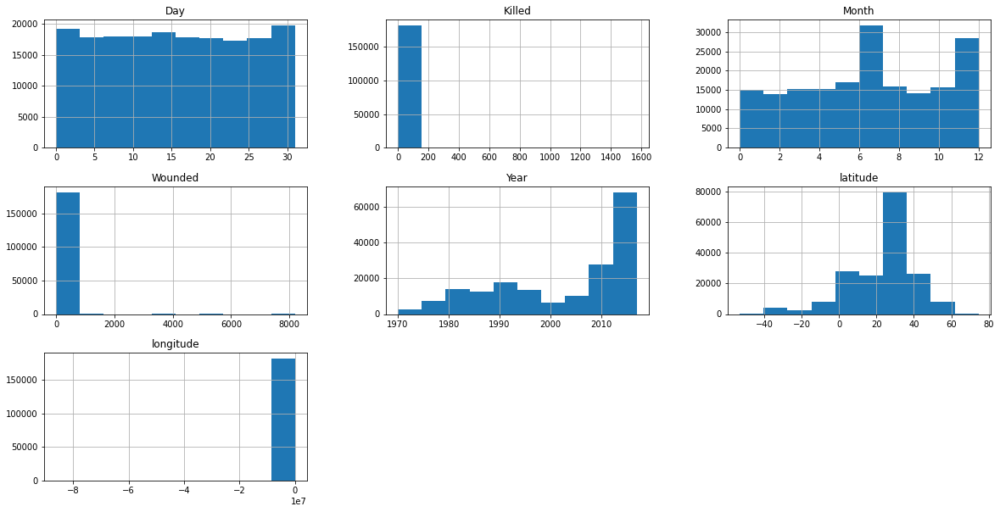

In [17]:
data.hist(figsize=(20,10))  # This represents  the distribution of data  on each series in the DataFrame.

In [18]:
data.describe()

,Year,Month,Day,latitude,longitude,Killed,Wounded
count,181691.000000,181691.000000,181691.000000,181691.000000,1.816910e+05,181691.000000,181691.000000
mean,2002.638997,6.467277,15.505644,23.744214,-4.460782e+02,2.266860,2.883296
std,13.259430,3.388303,8.814045,18.398930,2.021946e+05,11.227057,34.309747
min,1970.000000,0.000000,0.000000,-53.154613,-8.618590e+07,0.000000,0.000000
25%,1991.000000,4.000000,8.000000,11.849620,6.655000e+00,0.000000,0.000000
50%,2009.000000,6.000000,15.000000,31.633078,4.364658e+01,0.000000,0.000000
75%,2014.000000,9.000000,23.000000,34.538560,6.835734e+01,2.000000,2.000000
max,2017.000000,12.000000,31.000000,74.633553,1.793667e+02,1570.000000,8191.000000


## Correlation Analysis

<AxesSubplot:>

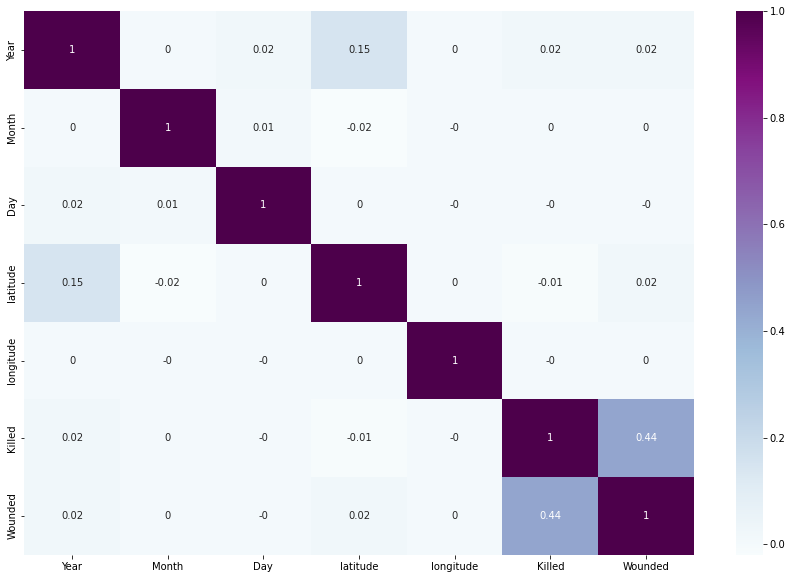

In [19]:
plt.figure(figsize=(15,10))
#This shows how much related is one parameter to the other in the dataset. 
sns.heatmap(np.round(data.corr(),2),annot=True, cmap='BuPu')

## **Terrorist Activities by Region in each Year through Area Plot**

In [ ]:
plt.figure(figsize=(15,6))
plt.bar(data['Year'].iloc[:5],data['Region'].iloc[:5])
plt.title('Terrorist Activities by Region in each Year')
plt.ylabel('Number of Attacks')
plt.show()

## **Number of Terrorist Activities each Year**

c:\users\nabin adhikari\appdata\local\programs\python\python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


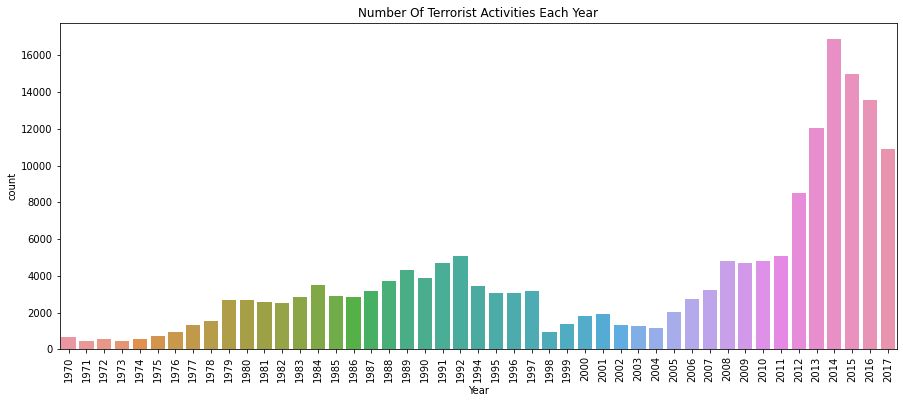

In [41]:
plt.subplots(figsize=(15,6))
sns.countplot('Year',data=data)
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

### **Since 2014 and 2015 has a large number of Terrorist activities.**

### **Number of attack were there in 1970 & 2017 and Also find percentage the attacks have increased.**


In [43]:
Year=data['Year'].value_counts().to_dict()
rate=((Year[2017]-Year[1970])/Year[2017])*100
print(Year[1970],'attacks happened in 1970 &',Year[2017],'attacks happened in 2017')
print('So the number of attacks from 1970 has increased by',np.round(rate,0),'% till 2017')

651 attacks happened in 1970 & 10900 attacks happened in 2017
So the number of attacks from 1970 has increased by 94.0 % till 2017


In [47]:
Year

{2014: 16903,
 2015: 14965,
 2016: 13587,
 2013: 12036,
 2017: 10900,
 2012: 8522,
 2011: 5076,
 1992: 5071,
 2010: 4826,
 2008: 4805,
 2009: 4721,
 1991: 4683,
 1989: 4324,
 1990: 3887,
 1988: 3721,
 1984: 3495,
 1994: 3456,
 2007: 3242,
 1997: 3197,
 1987: 3183,
 1995: 3081,
 1996: 3058,
 1985: 2915,
 1983: 2870,
 1986: 2860,
 2006: 2758,
 1979: 2662,
 1980: 2662,
 1981: 2586,
 1982: 2544,
 2005: 2017,
 2001: 1906,
 2000: 1814,
 1978: 1526,
 1999: 1395,
 2002: 1333,
 1977: 1319,
 2003: 1278,
 2004: 1166,
 1998: 934,
 1976: 923,
 1975: 740,
 1970: 651,
 1974: 581,
 1972: 568,
 1973: 473,
 1971: 471}

### **The number of casualities corresponding to the killed people in each country for each year.**

In [48]:
px.scatter(data,data.Wounded,data.Killed,hover_name='Country',animation_frame='Year',animation_group='Country',color='AttackType',
           range_color=[0,1],labels={'Killed':'Deaths','Wounded':'Casualities'},
           title='Number of casualities vs Killed people in each country for each year')

## Methods of attack

c:\users\nabin adhikari\appdata\local\programs\python\python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



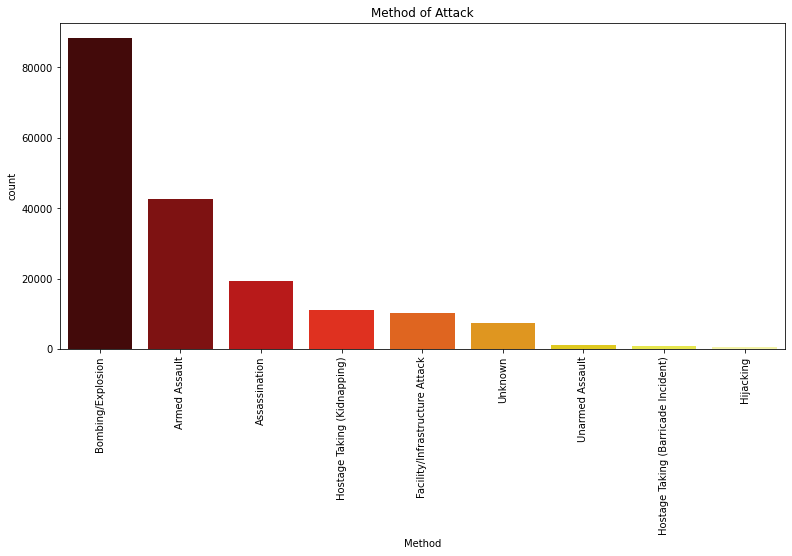

In [49]:
plt.figure(figsize=(13,6))
sns.countplot(data['AttackType'],order=data['AttackType'].value_counts().index,
              palette='hot')
plt.xticks(rotation=90)
plt.xlabel('Method')
plt.title('Method of Attack')
plt.show()

### **Since from the above chart it is clear that Bombing/Explosion method was mostly used.**

## Type of target

c:\users\nabin adhikari\appdata\local\programs\python\python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



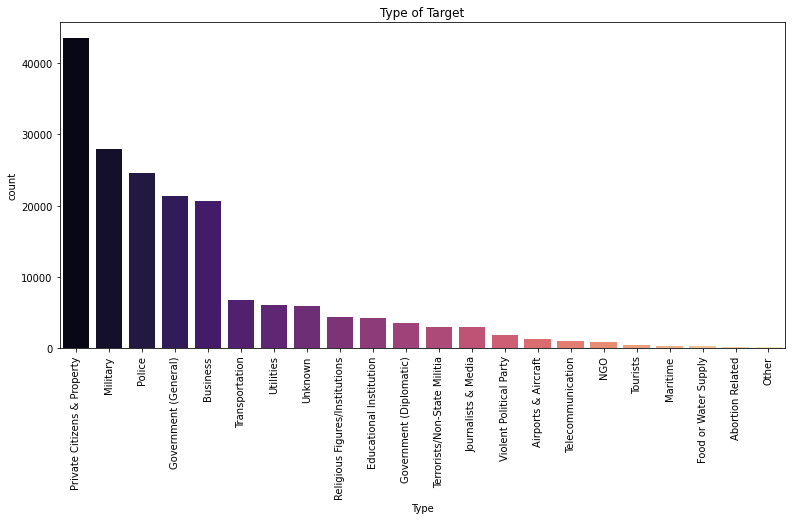

In [56]:
plt.figure(figsize=(13,6))
sns.countplot(data['Target_type'],order=data['Target_type'].value_counts().index,
              palette='magma')
plt.xticks(rotation=90)
plt.xlabel('Type')
plt.title('Type of Target')
plt.show()


## **Total number of terrorist attack in each country and regions using barplot**

In [60]:
data['Country'].value_counts()[:20].values

array([24636, 14368, 12731, 11960,  8306,  6908,  6096,  5320,  5235,
        4292,  4142,  3907,  3849,  3347,  3249,  3022,  2836,  2743,
        2693,  2479], dtype=int64)

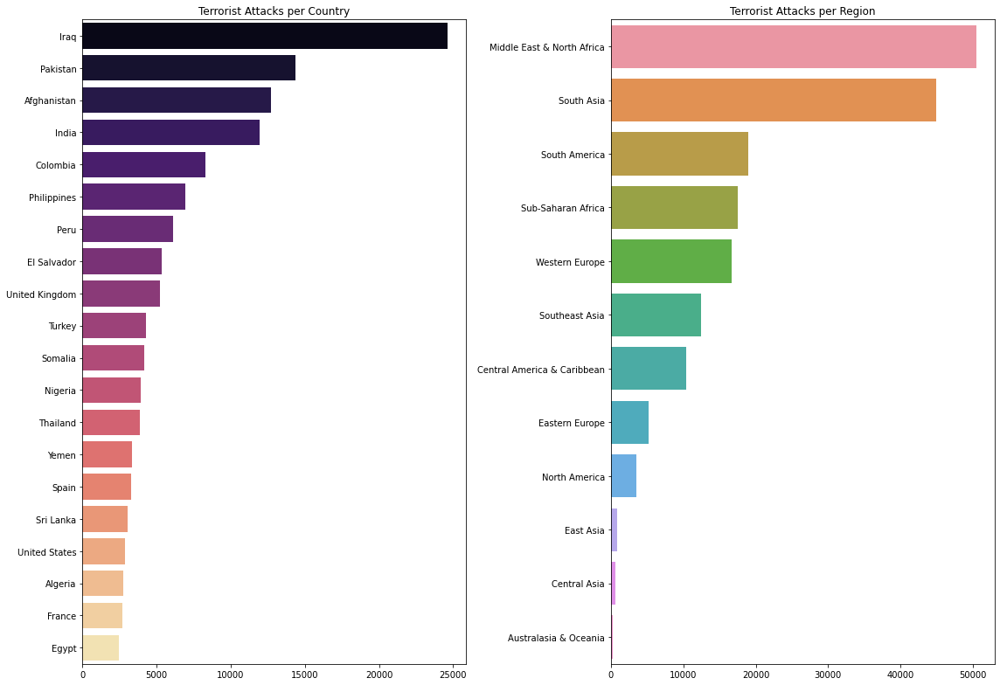

In [57]:
fig,axes = plt.subplots(figsize=(16,11),nrows=1,ncols=2)
sns.barplot(x = data['Country'].value_counts()[:20].values, y = data['Country'].value_counts()[:20].index, 
            ax=axes[0],palette = 'magma');
axes[0].set_title('Terrorist Attacks per Country')
sns.barplot(x=data['Region'].value_counts().values,y=data['Region'].value_counts().index,
            ax=axes[1])
axes[1].set_title('Terrorist Attacks per Region')
fig.tight_layout()
plt.show()

## **The total number of attacks in each country using Globe**

### **We will first create a new dataframe which contains the total count of attacks for each country in order to use it as a colour bar.**

In [61]:
terr=data.groupby(['Country'],as_index=False).count()

In [62]:
fig=px.choropleth(terr,locations='Country',locationmode='country names',
                  color='Year',hover_name='Country',projection='orthographic',
                  title='Total number of attacks (1970-2017)',labels={'Year':'Attacks'})
fig.show()

## **Country suffered the maximum attacks(state the number) and country suffered minimum attacks(state the number)**

In [63]:
max_count=terr['Year'].max()
max_id=terr['Year'].idxmax()
max_name=terr['Country'][max_id]
min_count=terr['Year'].min()
min_id=terr['Year'].idxmin()
min_name=terr['Country'][min_id]

In [64]:
print(max_name,'has suffered the maximum number of terror attacks of',max_count)
print(min_name,'has suffered the minimum number of terror attacks of',min_count)

Iraq has suffered the maximum number of terror attacks of 24636
Andorra has suffered the minimum number of terror attacks of 1


## **Now let us check out which terrorist organizations have carried out their operations in each country.**

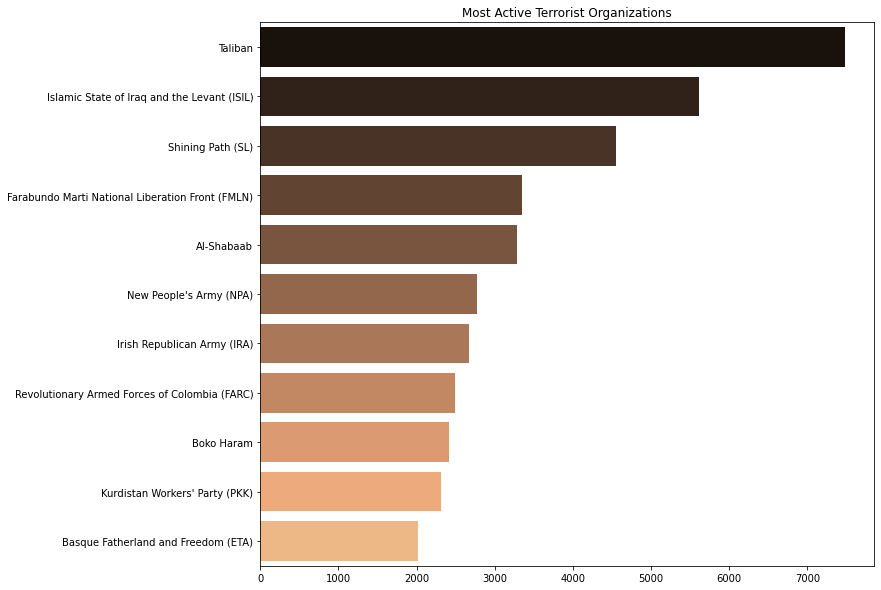

In [65]:
plt.subplots(figsize=(11,10))
sns.barplot(y=data['Group'].value_counts()[1:12].index,x=data['Group'].value_counts()[1:12].values,
           palette='copper')
plt.title('Most Active Terrorist Organizations')
plt.show()


## **Now we will look closer at trend Before and after the War on Terror**

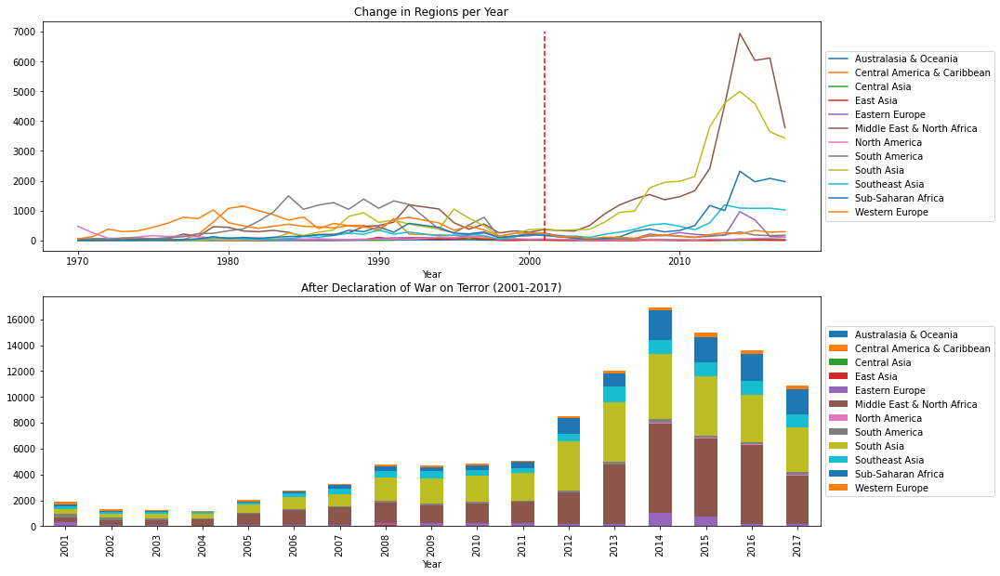

In [66]:
data_after = data[data['Year']>=2001]
fig,ax = plt.subplots(figsize=(15,10),nrows=2,ncols=1)
ax[0] = pd.crosstab(data.Year,data.Region).plot(ax=ax[0])
ax[0].set_title('Change in Regions per Year')
ax[0].legend(loc='center left',bbox_to_anchor = (1,0.5))
ax[0].vlines(x=2001,ymin=0,ymax=7000,colors='red',linestyles='--')
pd.crosstab(data_after.Year,data_after.Region).plot.bar(stacked=True,ax=ax[1])
ax[1].set_title('After Declaration of War on Terror (2001-2017)')
ax[1].legend(loc='center left',bbox_to_anchor = (1,0.5))
plt.show()


From the first plot, it is very noticeable that the terrorism landscape before and after the War on Terror is vastly different. Before 2001, the regions were much closer together in terms of activity, eventually all dropping to a minimum in 2000. After 2001, the Middle East and South Asia have dictated the rise in terrorism numbers, with a significant increase in Sub-Saharan Africa as well


## Insights derived from the above EDA:
1) Attacks has increased but number of people killed manier times as attack happened.<br/>
2) Iraq has the most attacks.<br/>
3) The Middle East and North Africa Regions has most taregeted.<br/>
4) Maximum number of attacks are from Bombing/Explosions.<br/>
5) There are maximum number of attacks in Private citizens and Property.<br/>
6) Taliban and ISIL has a most active organisation.<br/>